In [1]:
include("../pic3d.jl")
using .PIC3D
using PyPlot
using LinearAlgebra
using PyCall
anim =  pyimport("matplotlib.animation");
using BenchmarkTools

In [2]:
function generate_particles!(NP, d)
    num = d / (2*NP / (PIC3D.XL*PIC3D.YL*PIC3D.ZL))
    println(num)
    electrons = PIC3D.Species(q=PIC3D.q_e*num, m=PIC3D.m_e*num)
    ions = PIC3D.Species(q=-PIC3D.q_e*num, m=PIC3D.m_e*num*2000)
    @inbounds for i = 1:NP
        x = [rand()*PIC3D.XL, rand()*PIC3D.YL, rand()*PIC3D.ZL]
        v = [5e5, 0, 0]
        push!(electrons.x, [x...])
        push!(electrons.v, [v...])
        push!(ions.x, [x...])
        push!(ions.v, [0.0, 0.0, 0.0])
        
        x = [rand()*PIC3D.XL, rand()*PIC3D.YL, rand()*PIC3D.ZL] #[rand()*PIC3D.XL, rand()*PIC3D.YL, rand()*PIC3D.ZL]
        v = [-5e5, 0, 0]
        push!(electrons.x, [x...])
        push!(electrons.v, [v...])
        push!(ions.x, [x...])
        push!(ions.v, [0.0, 0.0, 0.0])
    end

    return electrons, ions
end

generate_particles! (generic function with 1 method)

In [3]:
function compute_EK_particles(electrons, ions)
    ek = 0
    @inbounds for i in eachindex(electrons.v)
        ek += electrons.m*dot(electrons.v[i], electrons.v[i])
    end
    @inbounds for i in eachindex(ions.v)
        ek += ions.m*dot(ions.v[i], ions.v[i])
    end
    ek = 0.5*ek
    return ek
end

function compute_EK_particles2(electrons, ions, NP, d)
    ek = 0
    @inbounds for i in eachindex(electrons.v)
        ek += electrons.m*dot(electrons.v[i], electrons.v[i])
    end
    @inbounds for i in eachindex(ions.v)
        ek += electrons.m*dot(ions.v[i], ions.v[i])
    end
    ek = 0.5*ek*(d / (2*NP / (PIC3D.Δx*PIC3D.Δy*PIC3D.Δz)))
    return ek
end

function compute_EP_field()
    ep = 0
    @inbounds for k = 1:(PIC3D.NZ-1), j = 1:(PIC3D.NY-1), i = 1:(PIC3D.NX-1)
        ep += PIC3D.Ex[i,j,k]^2 + PIC3D.Ey[i,j,k]^2 + PIC3D.Ez[i,j,k]^2
    end
    ep = 0.5 * PIC3D.ε_0 * ep * PIC3D.Δx*PIC3D.Δy*PIC3D.Δz
    return ep
end


function compute_EP_potential()
    ep = 0
    @inbounds for k = 1:(PIC3D.NZ-1), j = 1:(PIC3D.NY-1), i = 1:(PIC3D.NX-1)
        ep += PIC3D.ρ[i,j,k] * PIC3D.ϕ[i,j,k]
    end
    ep = 0.5* PIC3D.ε_0 *ep
    return ep
end

compute_EP_potential (generic function with 1 method)

In [115]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)
PIC3D.timestep!(electrons, ions)
@btime PIC3D.compute_potential!()

1.0986328125e6
  1.323 ms (0 allocations: 0 bytes)


In [71]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)
PIC3D.timestep!(electrons, ions)
@btime PIC3D.compute_potential!()

1.0986328125e6
  129.400 μs (0 allocations: 0 bytes)


In [23]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

@btime PIC3D.timestep_multigrid!(electrons, ions)

1.0986328125e6
GS failed to converge, L2 = 0.002645873698605617
GS failed to converge, L2 = 0.0026460502548774053
GS failed to converge, L2 = 0.0026731515773787324
GS failed to converge, L2 = 0.0026642057314192427
  7.290 s (41109 allocations: 3.14 MiB)


In [22]:
size(historyxx)

(120,)

MovieWriter ffmpeg unavailable; using Pillow instead.


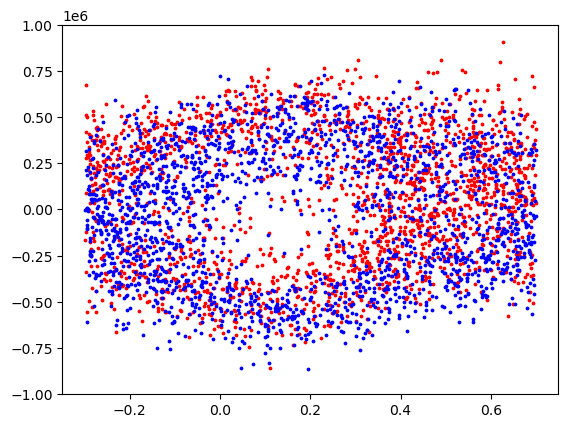

In [10]:
fig = plt.figure()
ax = plt.gca()
ax.set_ylim([-1e6,1e6])
function make_frame(i)
    plt.cla()
 ax.set_ylim([-1e6,1e6])
    firstx = historyxx[i+1][1:2:(size(historyxx[1])[1])]
    firstv = historyvel[i+1][1:2:(size(historyxx[1])[1])]
    plt.scatter([p[1]-0.3 for p in firstx], [p[1] for p in firstv], s =3, color="red")
    secondx = historyxx[i+1][2:2:(size(historyxx[1])[1] )]
    secondv = historyvel[i+1][2:2:(size(historyxx[1])[1])]
    plt.scatter([p[1]-0.3 for p in secondx], [p[1] for p in secondv], s =3, color="blue")
end

myanim = anim.FuncAnimation(fig, make_frame, frames=size(historyxx, 1), interval=100, blit=false)
myanim[:save]("tsi-popr3.gif", bitrate=-1)


1.0986328125e6
1
Converged after 175 iterations, L2 = 5.692962042877935e-9
2
Converged after 175 iterations, L2 = 5.726821778998488e-9
3
Converged after 175 iterations, L2 = 5.682991587472737e-9
4
Converged after 175 iterations, L2 = 5.65269068716915e-9
5
Converged after 175 iterations, L2 = 5.636607697279808e-9
6
Converged after 175 iterations, L2 = 5.637848156788308e-9
7
Converged after 175 iterations, L2 = 5.598977384230433e-9
8
Converged after 175 iterations, L2 = 5.600394455402526e-9
9
Converged after 175 iterations, L2 = 5.601387789877969e-9
10
Converged after 175 iterations, L2 = 5.604465922733662e-9
11
Converged after 175 iterations, L2 = 5.657758025052572e-9
12
Converged after 175 iterations, L2 = 5.63652711024024e-9
13
Converged after 175 iterations, L2 = 5.631502805902594e-9
14
Converged after 175 iterations, L2 = 5.632186197061649e-9
15
Converged after 175 iterations, L2 = 5.615229959213345e-9
16
Converged after 175 iterations, L2 = 5.6368743865028525e-9
17
Converged after 

sys:1: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown



Converged after 175 iterations, L2 = 5.627266981783647e-9
30
Converged after 175 iterations, L2 = 5.633813568735135e-9
31
Converged after 175 iterations, L2 = 5.615848235124647e-9
32
Converged after 175 iterations, L2 = 5.681612549294932e-9
33
Converged after 175 iterations, L2 = 5.666150101873685e-9
34
Converged after 175 iterations, L2 = 5.779277481192057e-9
35
Converged after 175 iterations, L2 = 5.818437946601e-9
36
Converged after 175 iterations, L2 = 5.757156503803883e-9
37
Converged after 175 iterations, L2 = 5.767278307405663e-9
38
Converged after 175 iterations, L2 = 5.759165015016658e-9
39
Converged after 175 iterations, L2 = 5.7567732000708815e-9
40
Converged after 175 iterations, L2 = 5.754773204187954e-9
41
Converged after 175 iterations, L2 = 5.723392169575534e-9
42
Converged after 175 iterations, L2 = 5.698096348753423e-9
43
Converged after 175 iterations, L2 = 5.705943367802476e-9
44
Converged after 175 iterations, L2 = 5.804129583095967e-9
45
Converged after 175 itera

sys:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



Converged after 175 iterations, L2 = 5.6190797820707605e-9
527
Converged after 175 iterations, L2 = 5.695812691164479e-9
528
Converged after 175 iterations, L2 = 5.6998420150644395e-9
529
Converged after 175 iterations, L2 = 5.6473118409718e-9
530
Converged after 175 iterations, L2 = 5.639504466514023e-9
531
Converged after 175 iterations, L2 = 5.691136034580362e-9
532
Converged after 175 iterations, L2 = 5.764288781647169e-9
533
Converged after 175 iterations, L2 = 5.887308227610067e-9
534
Converged after 175 iterations, L2 = 5.906622662438491e-9
535
Converged after 175 iterations, L2 = 5.987172359331602e-9
536
Converged after 175 iterations, L2 = 5.939267064845563e-9
537
Converged after 175 iterations, L2 = 5.952577316292939e-9
538
Converged after 175 iterations, L2 = 5.958668936037169e-9
539
Converged after 175 iterations, L2 = 5.963251063628925e-9
540
Converged after 175 iterations, L2 = 5.974618019409601e-9
541
Converged after 175 iterations, L2 = 5.9863140361680684e-9
542
Conver

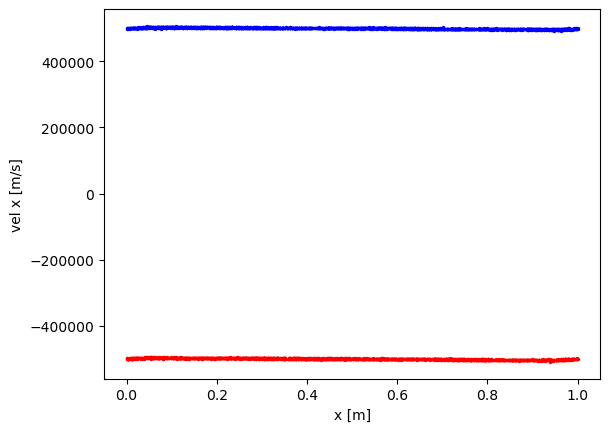

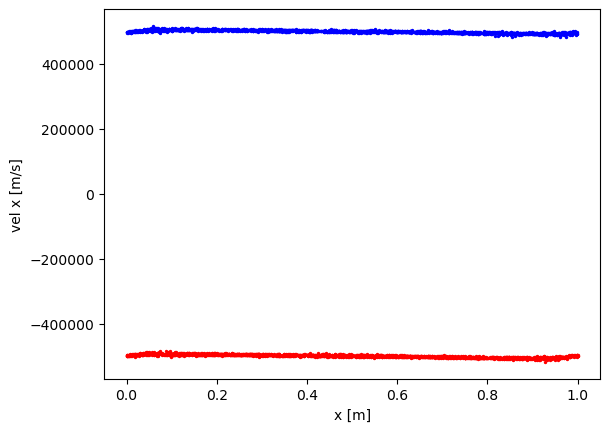

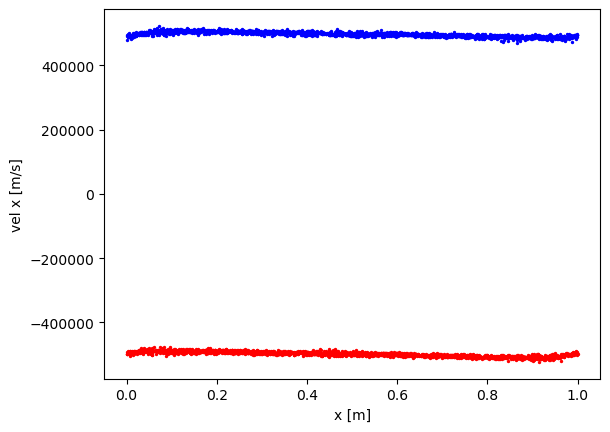

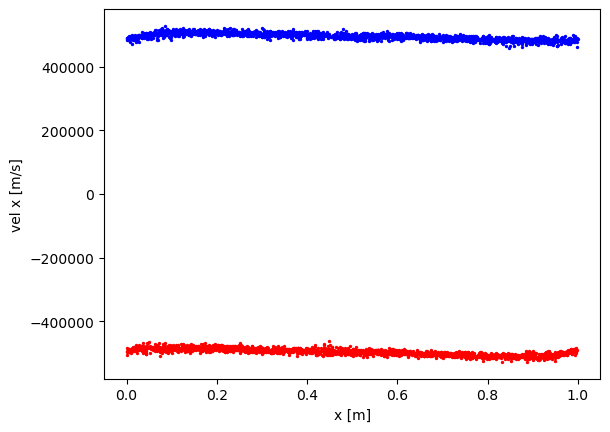

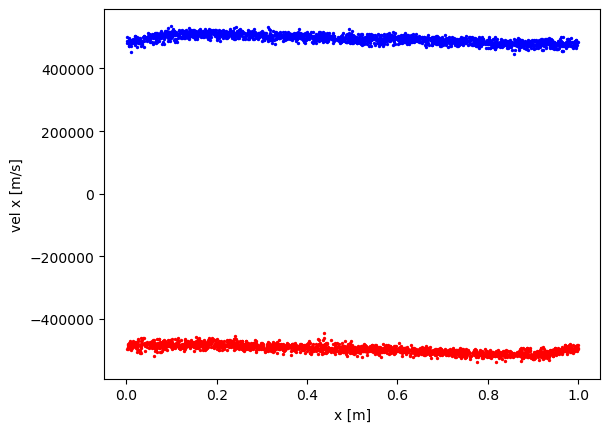

...

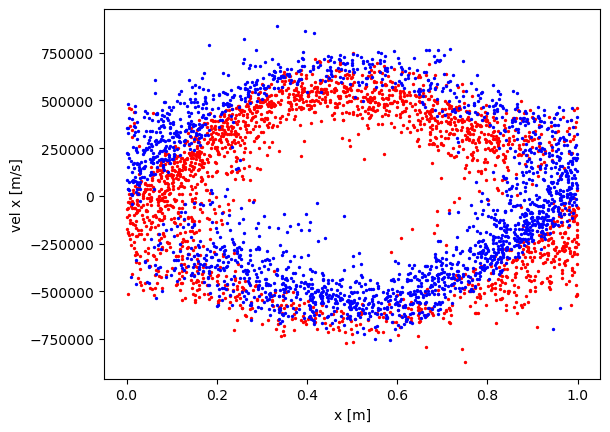

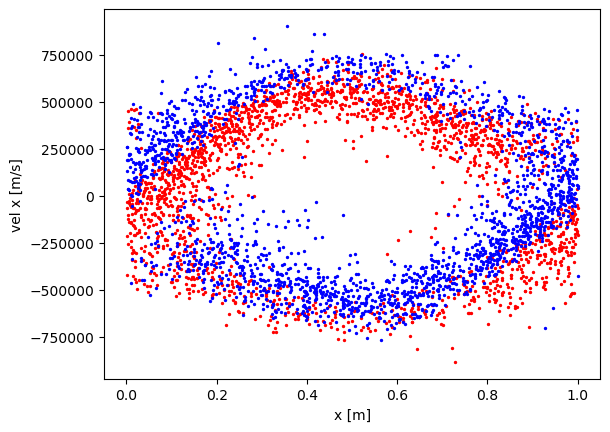

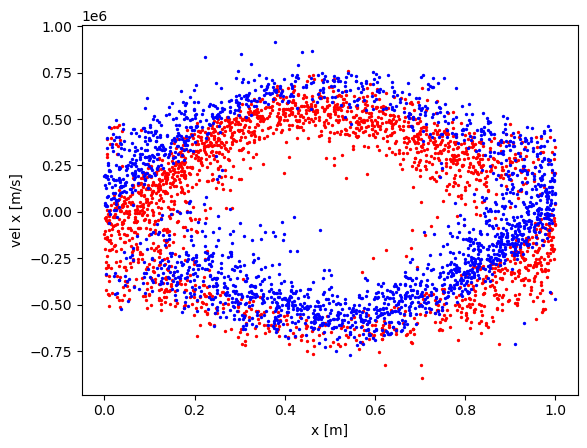

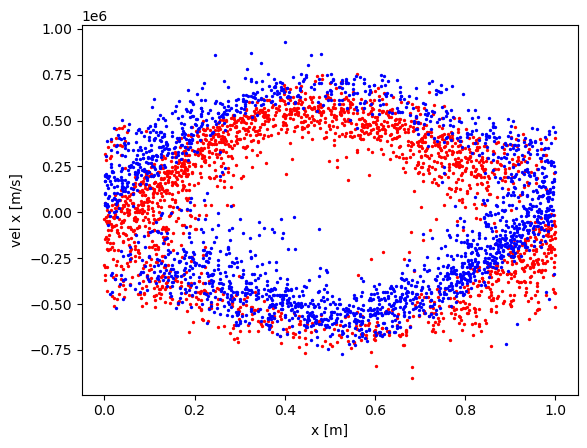

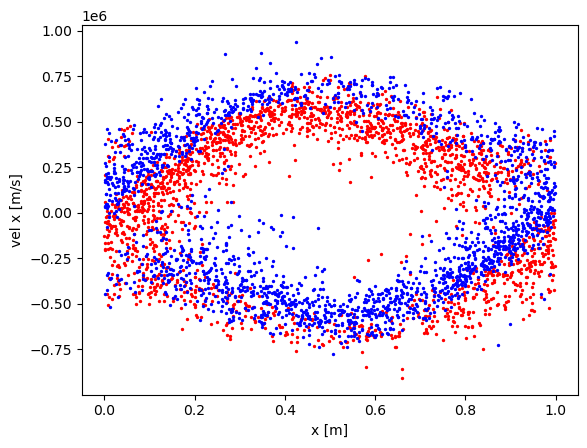

In [4]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

historyxx = []
historyvel = []
EK = []
EK2 = []
EE = []
EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep!(electrons, ions, 1)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

In [38]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

@btime PIC3D.timestep!(electrons, ions, 1.0)

1.0986328125e6
GS failed to converge, L2 = 0.002645792414300206
GS failed to converge, L2 = 0.002645968977827824
GS failed to converge, L2 = 0.002673069495888779
GS failed to converge, L2 = 0.0026641239657480744
GS failed to converge, L2 = 0.002673194607289417
GS failed to converge, L2 = 0.0026731968220033517
GS failed to converge, L2 = 0.002664225905976906
GS failed to converge, L2 = 0.0026642753787388114
GS failed to converge, L2 = 0.002673192312714111
GS failed to converge, L2 = 0.002673108158050531
GS failed to converge, L2 = 0.0026820091522425575
GS failed to converge, L2 = 0.0026859379962831014
  1.472 s (41107 allocations: 3.14 MiB)


In [23]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

@btime PIC3D.timestep!(electrons, ions, 1.0)

1.0986328125e6
GS failed to converge, L2 = 0.0025255150859355207
GS failed to converge, L2 = 0.0025347248484086085
GS failed to converge, L2 = 0.0025440035994413455
GS failed to converge, L2 = 0.0025353496010877773
  7.598 s (41110 allocations: 3.14 MiB)


1
Converged after 200 iterations, L2 = 3.464582904464753e-9
2
Converged after 200 iterations, L2 = 3.4653242511936327e-9
3
Converged after 200 iterations, L2 = 3.464812424816726e-9
4
Converged after 200 iterations, L2 = 3.4702561602361272e-9
5
Converged after 200 iterations, L2 = 3.4673643509299057e-9
6
Converged after 200 iterations, L2 = 3.4589642735106786e-9
7
Converged after 200 iterations, L2 = 3.4476735770656402e-9
8
Converged after 200 iterations, L2 = 3.4594502196819414e-9
9
Converged after 200 iterations, L2 = 3.4554925742028026e-9
10
Converged after 200 iterations, L2 = 3.4457225195349955e-9
11
Converged after 200 iterations, L2 = 3.434616086714261e-9
12
Converged after 200 iterations, L2 = 3.430471989866255e-9
13
Converged after 200 iterations, L2 = 3.426376452862482e-9
14
Converged after 200 iterations, L2 = 3.4307951548316222e-9
15
Converged after 200 iterations, L2 = 3.4301983749641797e-9
16
Converged after 200 iterations, L2 = 3.4220580856002173e-9
17
Converged after 200

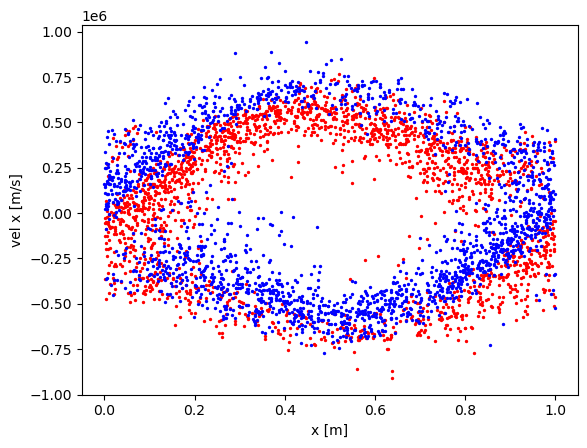

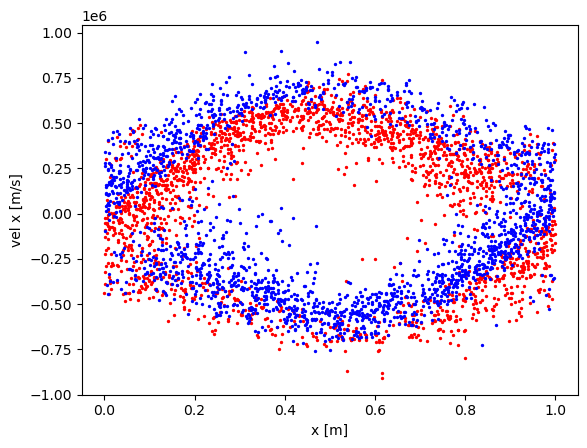

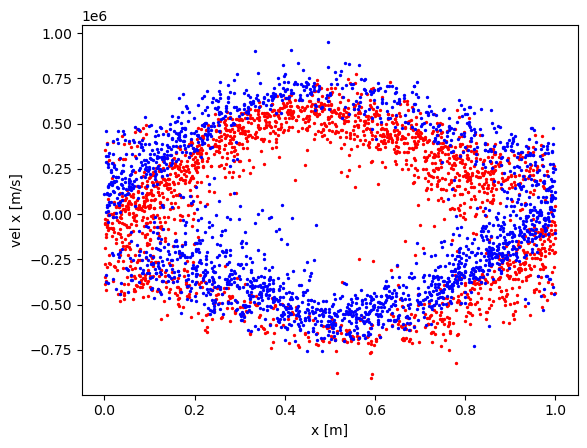

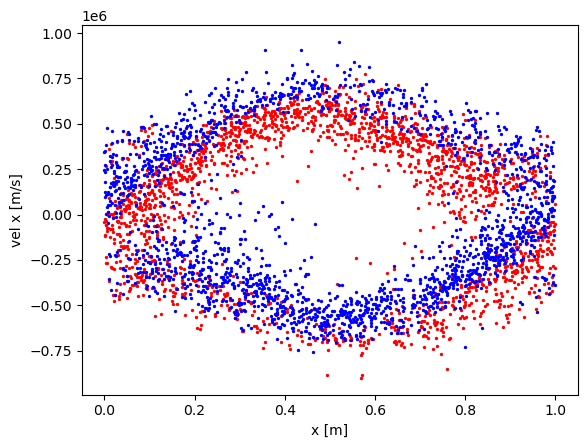

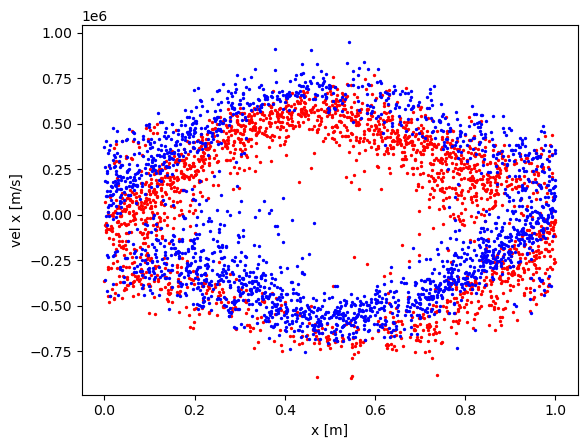

...

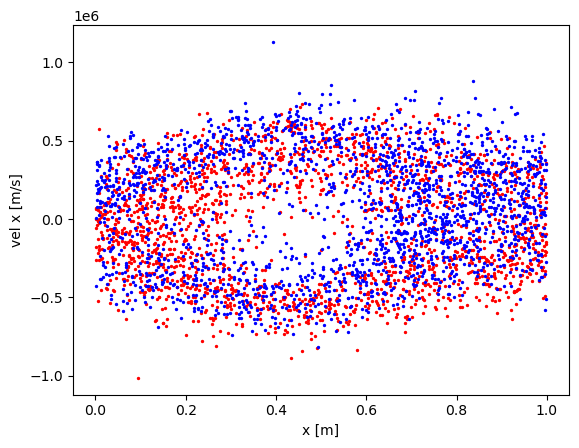

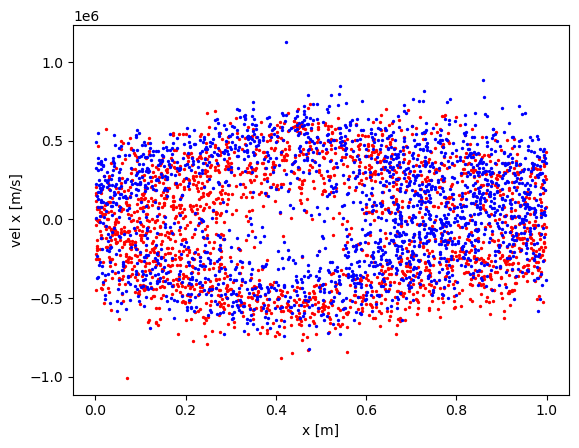

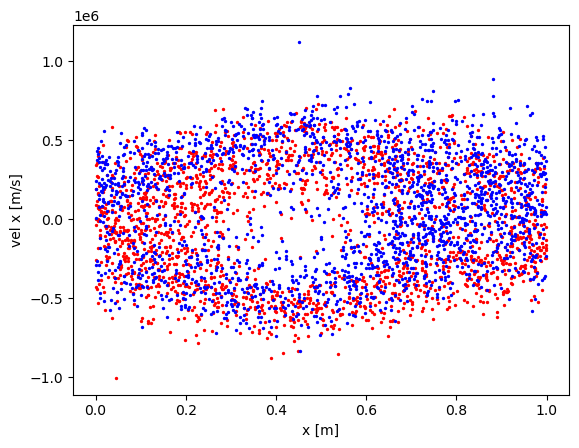

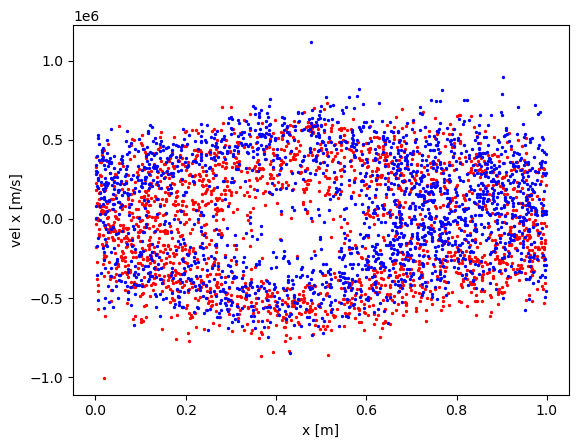

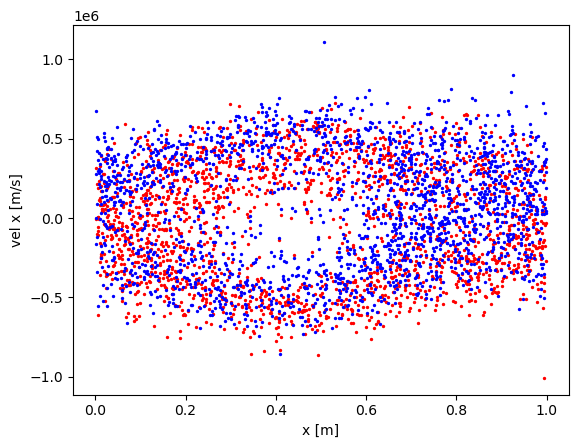

In [9]:
# NP = 2048 #2048
# d = 4.5e9
# electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 4000

# historyxx = []
# historyvel = []
# EK = []
# EK2 = []
# EE = []
# EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep!(electrons, ions, 1)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

1.0986328125e6
1
GS failed to converge, L2 = 0.002645792414299869
2
GS failed to converge, L2 = 0.0026459689778274846
3
GS failed to converge, L2 = 0.0026730694958885647
4
GS failed to converge, L2 = 0.0026641239657482366
5
GS failed to converge, L2 = 0.002673194607289381
6
GS failed to converge, L2 = 0.002673196822003501
7
GS failed to converge, L2 = 0.0026642259059771853
8
GS failed to converge, L2 = 0.0026642753787389666
9
GS failed to converge, L2 = 0.0026731923127142547
10
GS failed to converge, L2 = 0.00267310815805045
11
GS failed to converge, L2 = 0.002682009152242478
12
GS failed to converge, L2 = 0.002685937996283351
13
GS failed to converge, L2 = 0.0026751718125194537
14
GS failed to converge, L2 = 0.0026754219224229773
15
GS failed to converge, L2 = 0.0026667822104009926
16
GS failed to converge, L2 = 0.002667262549608136
17
GS failed to converge, L2 = 0.002676745157589588
18
GS failed to converge, L2 = 0.002704154560578515
19
GS failed to converge, L2 = 0.00270444339172896

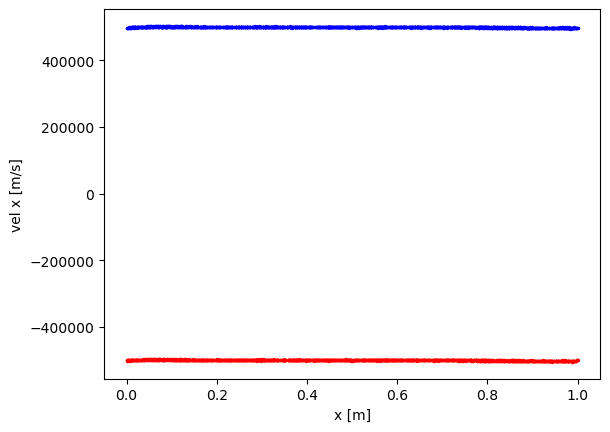

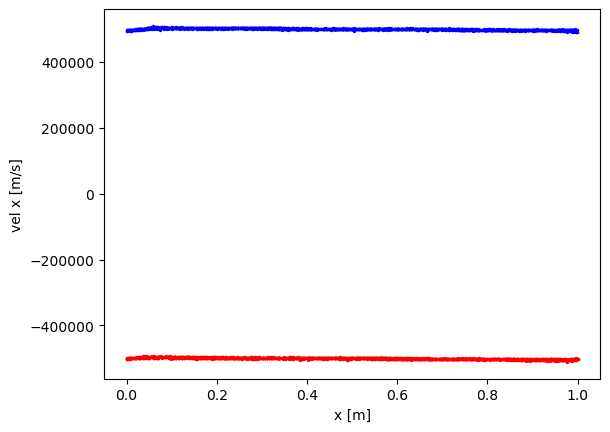

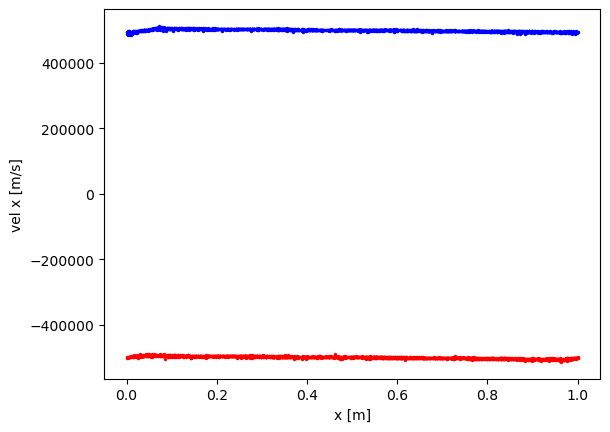

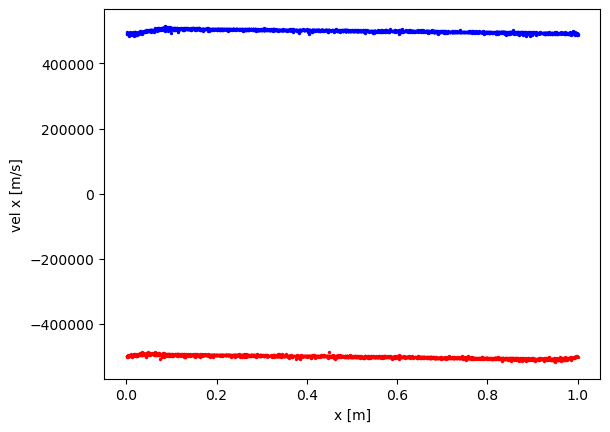

In [129]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 100

historyxx = []
historyvel = []
EK = []
EK2 = []
EE = []
EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep!(electrons, ions, 1.0)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

1.0986328125e6
1
GS failed to converge, L2 = 0.002645802733115265
2
GS failed to converge, L2 = 0.0026459796396390207
3
GS failed to converge, L2 = 0.0026730811030247223
4
GS failed to converge, L2 = 0.002664136634661723
5
GS failed to converge, L2 = 0.0026732091551245085
6
GS failed to converge, L2 = 0.0026732140776757132
7
GS failed to converge, L2 = 0.0026642450941170904
8
GS failed to converge, L2 = 0.00266429782556715
9
GS failed to converge, L2 = 0.002673219457276672
10
GS failed to converge, L2 = 0.002673139318515591
11
GS failed to converge, L2 = 0.002682045833831452
12
GS failed to converge, L2 = 0.002685979906695252
13
GS failed to converge, L2 = 0.0026752162307852483
14
GS failed to converge, L2 = 0.0026754687197348068
15
GS failed to converge, L2 = 0.0026668319154540474
16
GS failed to converge, L2 = 0.0026673170785962495
17
GS failed to converge, L2 = 0.0026768093228671306
18
GS failed to converge, L2 = 0.002704227497633813
19
GS failed to converge, L2 = 0.0027045242155373

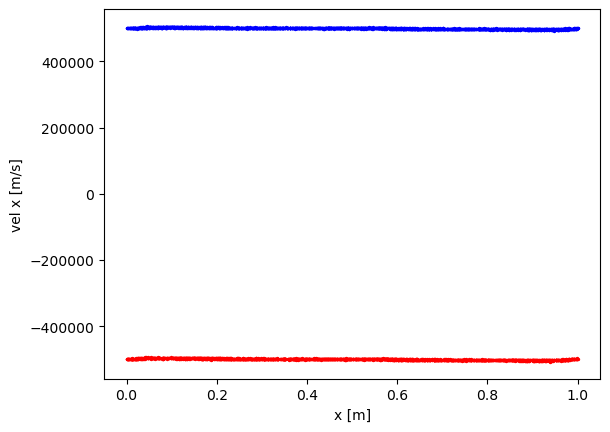

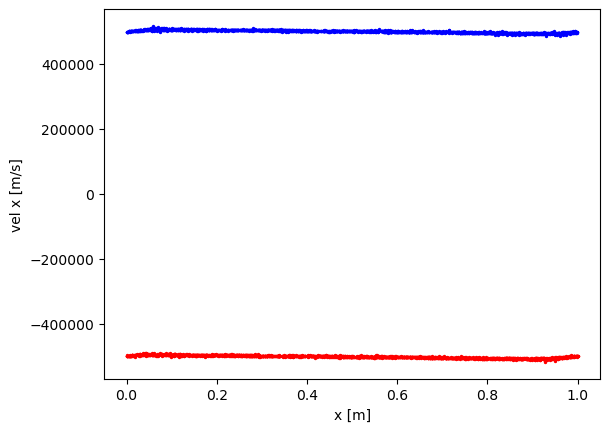

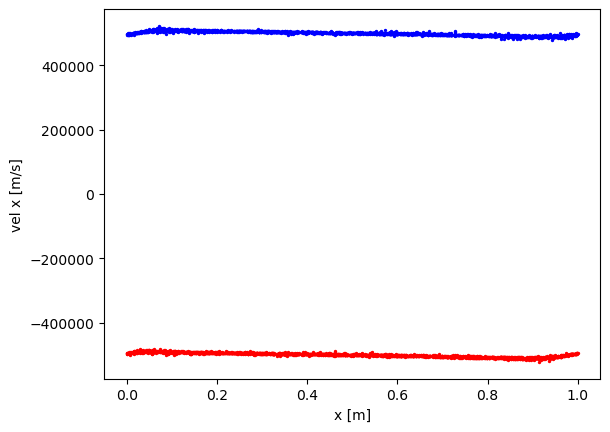

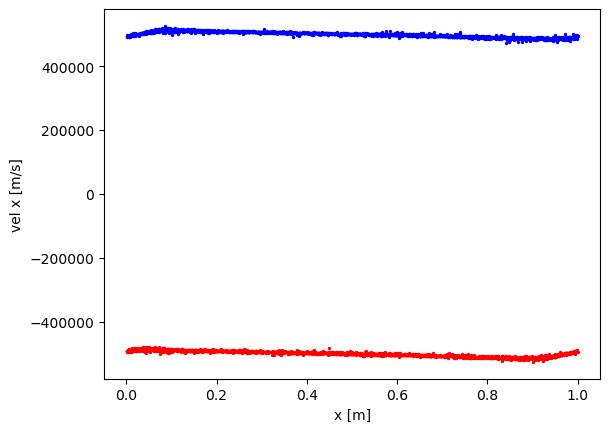

In [11]:
NP = 2048 #2048
d = 4.5e9
electrons, ions = generate_particles!(NP, d)

Δt = 1e-9
timesteps = 3000

historyxx = []
historyvel = []
EK = []
EK2 = []
EE = []
EP = []

for i = 1:timesteps
    println(i)
    PIC3D.timestep!(electrons, ions, 1.0)
    if i % 25 == 0
        plt.figure()
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 0],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 0], color="red", label="c = 1", s=2)
        plt.scatter([electrons.x[i][1] for i in eachindex(electrons.x) if i % 2 == 1],
                    [electrons.v[i][1] for i in eachindex(electrons.v) if i % 2 == 1], color="blue", label="c = 1", s=2)
        plt.xlabel("x [m]")
        plt.ylabel("vel x [m/s]")
        plt.show()
        push!(historyxx, [[ex...] for ex in electrons.x])
        push!(historyvel, [[ev...] for ev in electrons.v])
    end
    push!(EK, compute_EK_particles(electrons, ions))
    push!(EK2, compute_EK_particles2(electrons, ions, NP, d))
    push!(EE, compute_EP_field())
    push!(EP, compute_EP_potential())
end

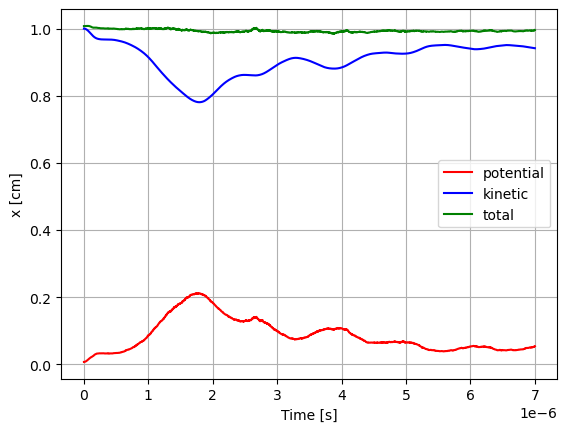

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [6]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red", label="potential")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue", label="kinetic")
plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green", label="total")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.legend()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

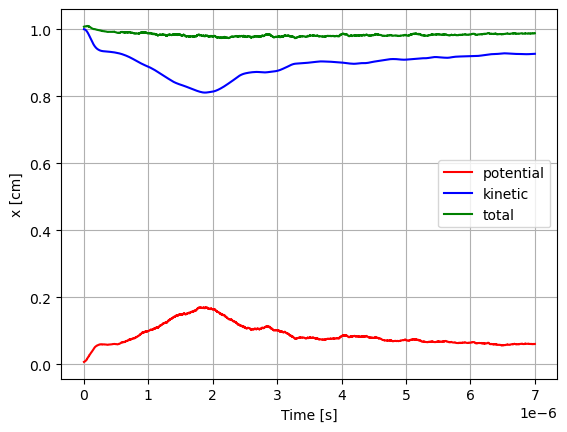

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [18]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red", label="potential")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue", label="kinetic")
plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green", label="total")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.legend()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

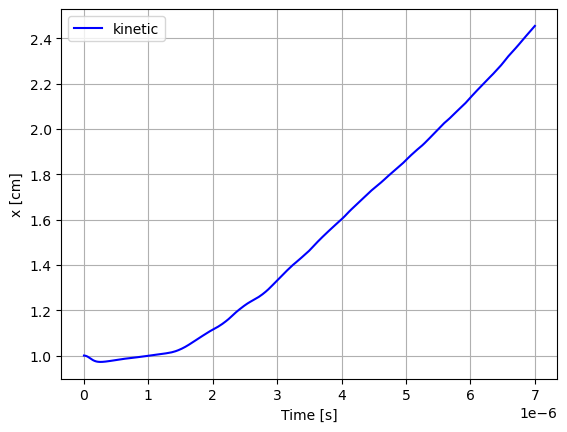

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [13]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
#plt.plot(times, EE ./ EK[1], linestyle="solid", color="red", label="potential")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue", label="kinetic")
#plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green", label="total")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.legend()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

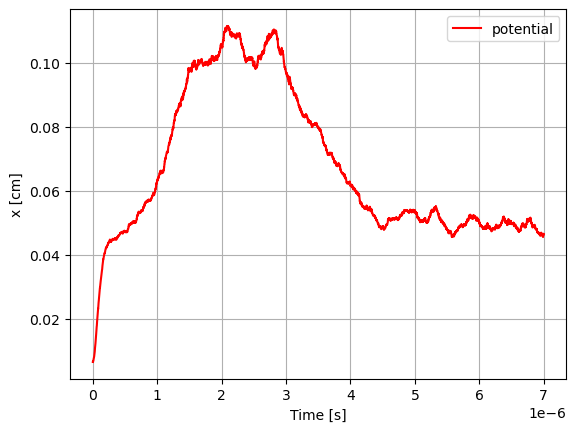

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [12]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red", label="potential")
#plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue", label="kinetic")
#plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green", label="total")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.legend()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

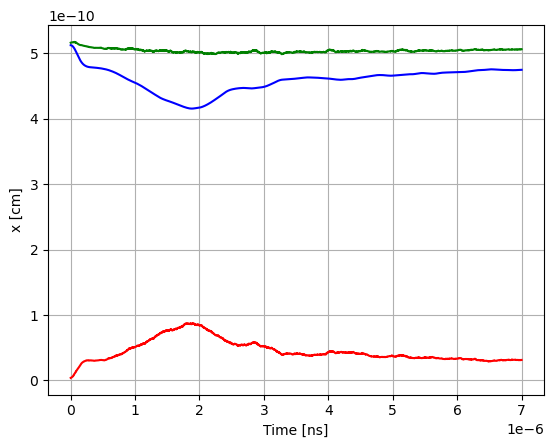

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [19]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE , linestyle="solid", color="red")
plt.plot(times, EK , linestyle="solid", color="blue")
plt.plot(times, EE + EK , linestyle="solid", color="green")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [ns]")
plt.ylabel("x [cm]")

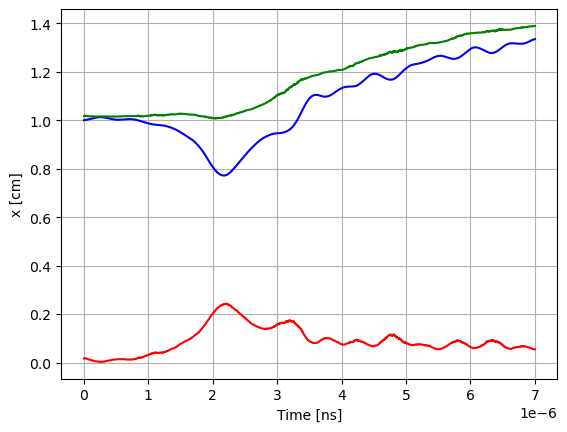

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [29]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue")
plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [s]")
plt.ylabel("x [cm]")

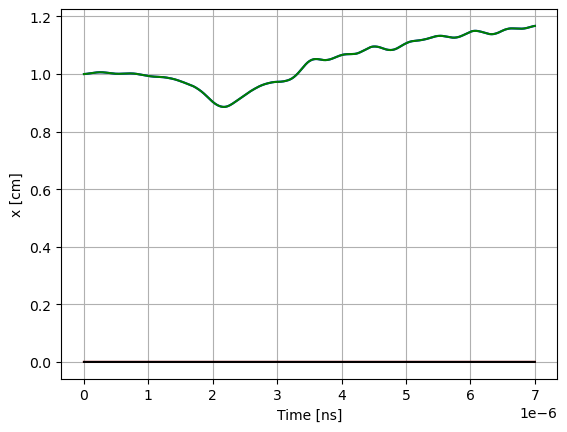

PyObject Text(24.000000000000007, 0.5, 'x [cm]')

In [22]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK2[1], linestyle="solid", color="red")
plt.plot(times, EK2 ./ EK2[1], linestyle="solid", color="blue")
plt.plot(times, EE ./ EK2[1] + EK2 ./ EK2[1], linestyle="solid", color="green")
plt.plot(times, EP ./ EK2[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [ns]")
plt.ylabel("x [cm]")

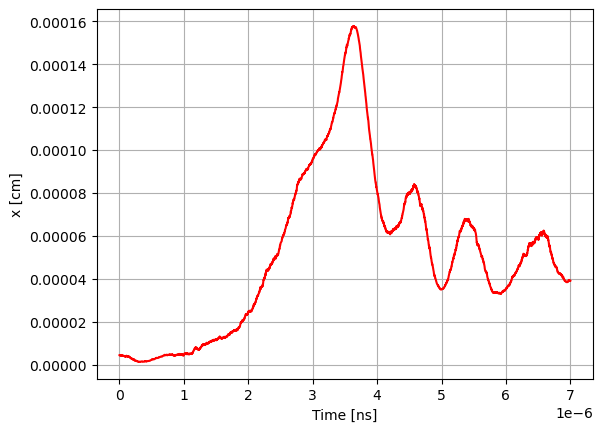

PyObject Text(24.0, 0.5, 'x [cm]')

In [66]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
plt.plot(times, EE ./ EK[1], linestyle="solid", color="red")
#plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue")
#plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [ns]")
plt.ylabel("x [cm]")

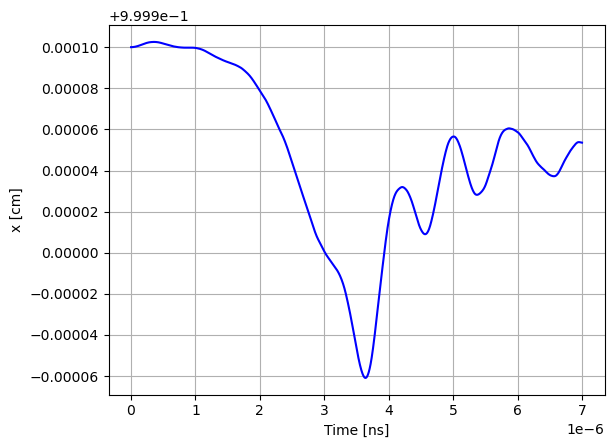

PyObject Text(24.0, 0.5, 'x [cm]')

In [67]:
fig = plt.figure()
times = [i*Δt for i=1:7000]
#plt.plot(times, EE ./ EK[1], linestyle="solid", color="red")
plt.plot(times, EK ./ EK[1], linestyle="solid", color="blue")
#plt.plot(times, EE ./ EK[1] + EK ./ EK[1], linestyle="solid", color="green")
#plt.plot(times, EP ./ EK[1], linestyle="solid", color="black")
plt.grid()
plt.xlabel("Time [ns]")
plt.ylabel("x [cm]")